# Detecting hypothyroid in patients
Determine whether a patient referred to the clinic is hypothyroid. Therefore three classes are built: normal (not hypothyroid), hyperfunction and subnormal functioning.The hyperfunction and subnormal classes are treated as outlier class and the other one as inliers class.
http://odds.cs.stonybrook.edu/annthyroid-dataset/

# Import Libraries

In [297]:
import seaborn as sns
import os
import pandas as pd
import numpy as np
import sklearn as sk
import scipy.io
import matplotlib.pyplot as plt
from sklearn import decomposition
from sklearn import preprocessing
from sklearn import cluster

# Data Import

In [298]:
data = scipy.io.loadmat('annthyroid.mat')

In [299]:
data_x = data['X']
data_y = data['y']

In [300]:
#Make a DF of the data
data_df = pd.DataFrame(data_x,index = range(data_x.shape[0]),
                       columns = range(data_x.shape[1]))

data_df['y'] = data_y

In [301]:
#Find indices in the data of the 2 class labels
class_0_index = np.where(data_y==0)[0]
class_1_index = np.where(data_y==1)[0]

# Sparsity check

In [302]:
data_df.isnull().any()

0    False
1    False
2    False
3    False
4    False
5    False
y    False
dtype: bool

In [303]:
data_df.shape

(7200, 7)

# Visualization
For both tasks, you should look at the plots before making use of the ground truth labels.
For your submission, use the ground truth labels to color the points in all scatter plots.

1.1 Visualize the univariate distributions of all features, jointly and per class.
Visualize the data using PCA (first two principal components).
Plot the explained variance ratio in PCA. What would be a good threshold for the number of
principal components if you wanted to reduce the dimensionality of the data to compress it?

1.2 Visualize the data using t-SNE. See if tuning the perplexity parameter helps obtaining a
better visualization.

## Task 1.1 
Visualize the univariate distributions of all features, jointly and per class.
Visualize the data using PCA (first two principal components).
Plot the explained variance ratio in PCA. What would be a good threshold for the number of
principal components if you wanted to reduce the dimensionality of the data to compress it?

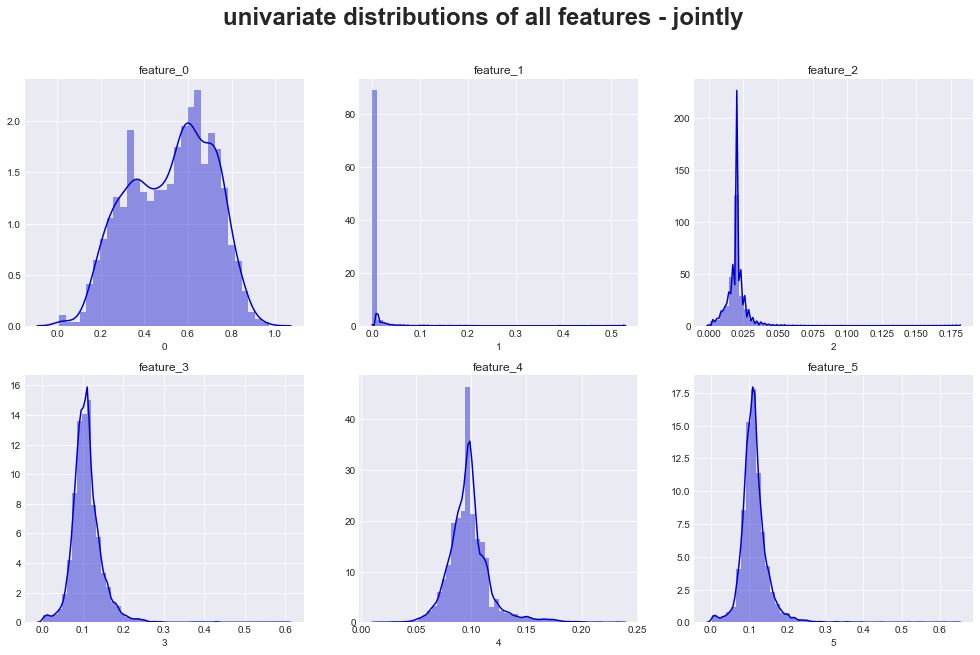

In [29]:
sns.set_style("darkgrid")
fig, axes = plt.subplots(2,3, figsize = (17,10))
features = list(data_df.columns)

for ax,feature in zip(axes.ravel(),features):
    #sns.distplot(x_df[feature],ax=ax,color='purple',bins=100,kde=False)
    sns.distplot(data_df[feature],ax=ax,color='mediumblue')
    ax.set_title('feature_'+str(feature))

plt.suptitle("univariate distributions of all features - jointly",
             fontsize=24,fontweight='bold')   
plt.show()

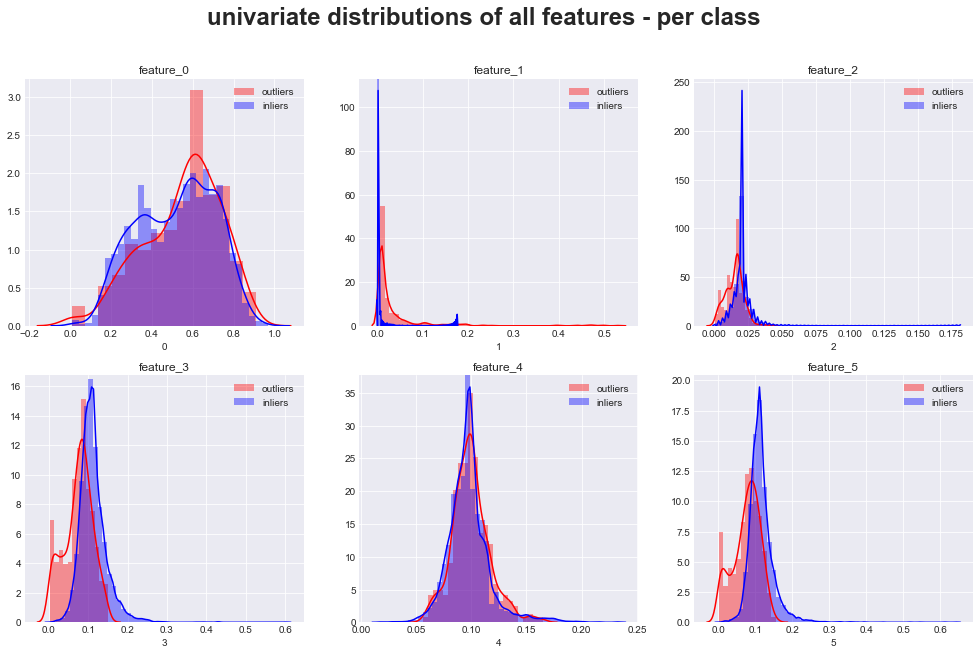

In [30]:
fig, axes = plt.subplots(2,3, figsize = (17,10))
features = list(data_df.columns)

for ax,feature in zip(axes.ravel(),features):
    class1_data = data_df[data_df.y==1]
    class0_data = data_df[data_df.y==0]
    #sns.distplot(class1_data[feature],ax=ax,color='red',bins=100,kde=False)
    sns.distplot(class1_data[feature],ax=ax,color='red',
                 label = 'outliers')
    #sns.distplot(class0_data[feature],ax=ax,color='blue',bins=100,kde=False)
    sns.distplot(class0_data[feature],ax=ax,color='blue',
                 label = 'inliers')
    ax.set_title('feature_'+str(feature))
    ax.legend()
#plt.legend()
plt.suptitle("univariate distributions of all features - per class",
             fontsize=24,fontweight='bold') 
plt.show()

In [70]:
#Scale data before PCA
scaler = preprocessing.StandardScaler()
scaler.fit(data_x)
data_x_scaled = scaler.transform(data_x)

In [71]:
#PCA of data
pca = decomposition.PCA(n_components=2)
pca.fit(data_x_scaled)
data_x_scaled_pca = pca.transform(data_x_scaled)
#x_scaled_pca_df = pd.DataFrame(data_x_scaled_pca,index=range(data_x_scaled_pca.shape[0]),columns=['component1','component2'])

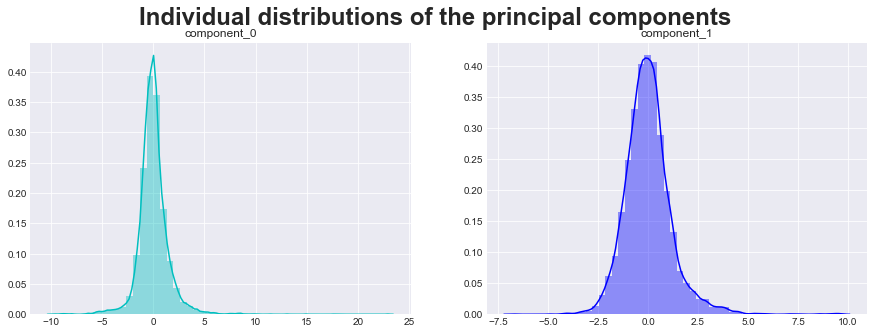

In [73]:
#Plot the univariate dist of Principal Components
fig, axes = plt.subplots(1,2,figsize = (15,5))
features = [0,1]
colors= ['c','b']
for ax,feature,c in zip(axes.ravel(),features,colors):
    sns.distplot(data_x_scaled_pca[:,feature],ax=ax,color=c)
    ax.set_title('component_'+str(feature))
plt.suptitle("Individual distributions of the principal components",
             fontsize=24,fontweight='bold') 
plt.show()

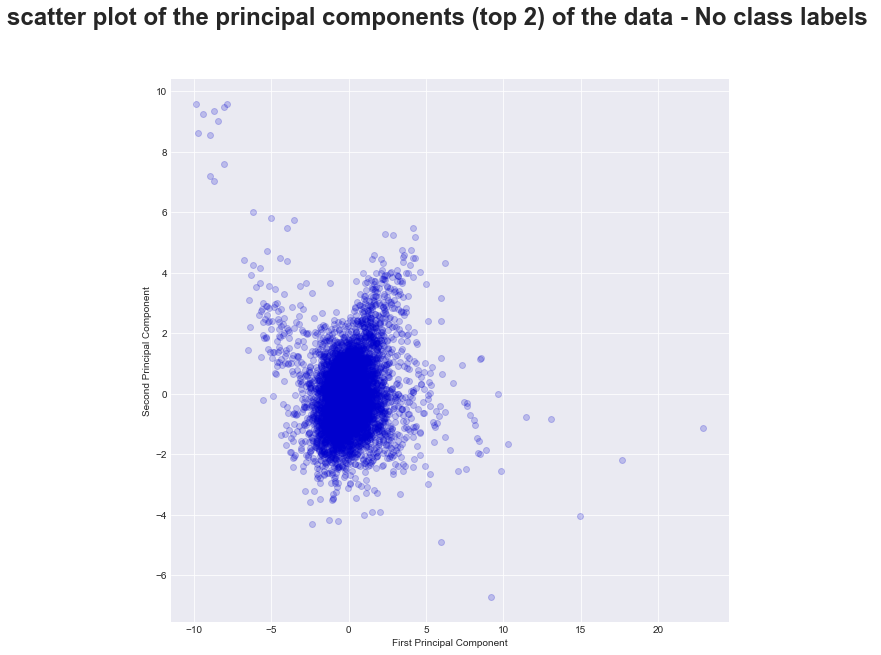

In [32]:
#Visualize data based on PCs without ground truth labels
fig, ax = plt.subplots(1,1,figsize = (10,10))
ax.scatter(data_x_scaled_pca[:,0],data_x_scaled_pca[:,1],
           alpha=0.2,c='mediumblue')
ax.set_xlabel('First Principal Component')
ax.set_ylabel('Second Principal Component')

plt.suptitle("scatter plot of the principal components (top 2) of the data - No class labels ",
             fontsize=24,fontweight='bold') 
plt.show()

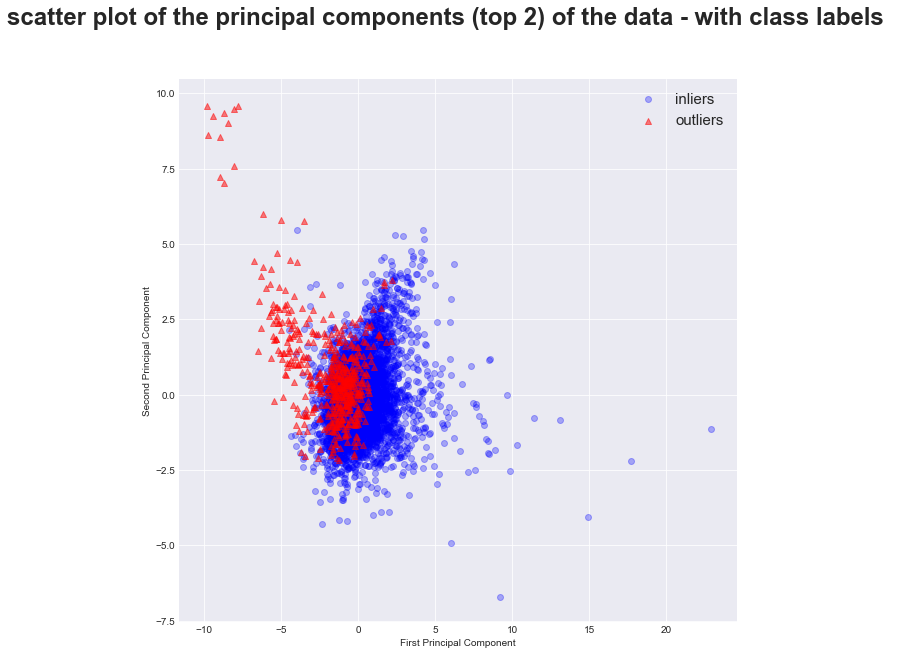

In [74]:
#Visualize PC data with ground truth class labels
fig, ax = plt.subplots(1,1,figsize = (10,10))
ax.scatter(data_x_scaled_pca[class_0_index,0],
           data_x_scaled_pca[class_0_index,1],
           alpha=0.3,c='mediumblue',label = 'inliers')
ax.scatter(data_x_scaled_pca[class_1_index,0],
           data_x_scaled_pca[class_1_index,1],
           alpha=0.5,c='red',marker='^',label = 'outliers')
ax.set_xlabel('First Principal Component')
ax.set_ylabel('Second Principal Component')

plt.suptitle("scatter plot of the principal components (top 2) of the data - with class labels ",
             fontsize=24,fontweight='bold') 
plt.legend( prop={'size': 15})
plt.show()

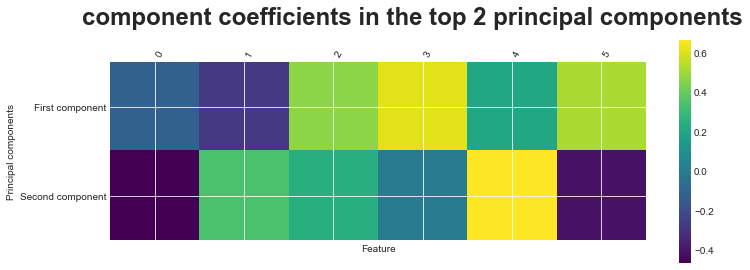

In [193]:
#Visualize component coefficients in the principal components
plt.matshow(pca.components_, cmap='viridis')
plt.yticks([0, 1], ["First component", "Second component"])
plt.colorbar()
plt.xticks(range(data_x.shape[1]),
range(data_x.shape[1]), rotation=60, ha='left')
plt.xlabel("Feature")
plt.ylabel("Principal components")
plt.suptitle("component coefficients in the top 2 principal components",fontsize=24,fontweight='bold') 
plt.show()

In [35]:
#Do PCA with all features to get all variance ratios
pca_ratios = decomposition.PCA(n_components=6)
pca_ratios.fit(data_x_scaled)

PCA(copy=True, iterated_power='auto', n_components=6, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

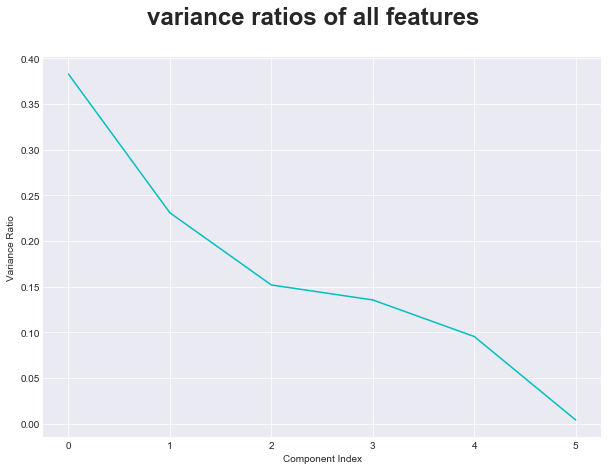

In [37]:
#Plot variance ratios
var_ratios = pca_ratios.explained_variance_ratio_
plt.figure(figsize=(10,7))

plt.plot(var_ratios,c='c')
#plt.title('Variance Plot')
plt.xlabel('Component Index')
plt.ylabel('Variance Ratio')
plt.suptitle("variance ratios of all features",
             fontsize=24,fontweight='bold') 
plt.show()
# plt.lines.line2d(var_ratios,range(6))
# plt.show()

##### What would be a good threshold for the number of principal components if you wanted to reduce the dimensionality of the data to compress it?
The above plot shows that the **optimal number of features is 4  (components - 0,1,2,3)** after which the plot tapers off sharply. 

## Task 1.2 
Visualize the data using t-SNE. See if tuning the perplexity parameter helps obtaining a
better visualization.

In [38]:
#TSNE plots of the multi dimensional data
from sklearn.manifold import TSNE
tsne = TSNE(random_state=17)
x_tsne = tsne.fit_transform(data_x_scaled)

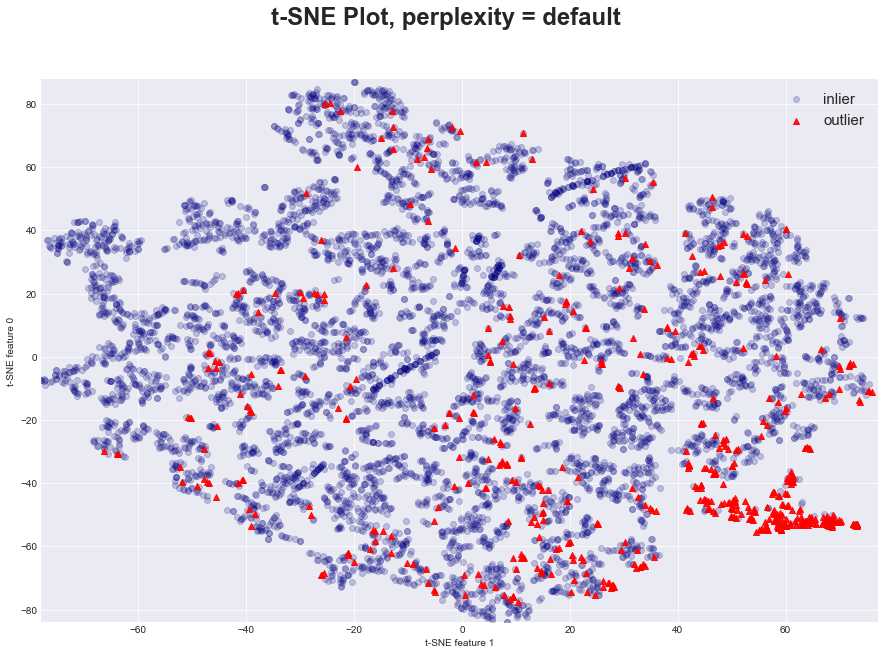

In [75]:
plt.figure(figsize=(15, 10))
plt.xlim(x_tsne[:, 0].min(), x_tsne[:, 0].max() + 1)
plt.ylim(x_tsne[:, 1].min(), x_tsne[:, 1].max() + 1)
plt.scatter(x_tsne[class_0_index,0],x_tsne[class_0_index,1],
            c='navy',marker='o',alpha=0.2,label='inlier')
plt.scatter(x_tsne[class_1_index,0],x_tsne[class_1_index,1],
            c='red',marker='^',alpha=0.9,label='outlier')
plt.ylabel("t-SNE feature 0")
plt.xlabel("t-SNE feature 1")
plt.suptitle('t-SNE Plot, perplexity = default',
             fontsize=24,fontweight='bold')
plt.legend(prop={'size': 15})
plt.show()

In [39]:
#new perplexity(=10) for tsne
tsne_10 = TSNE(random_state=17,perplexity=10)
x_tsne_10 = tsne_10.fit_transform(data_x_scaled)

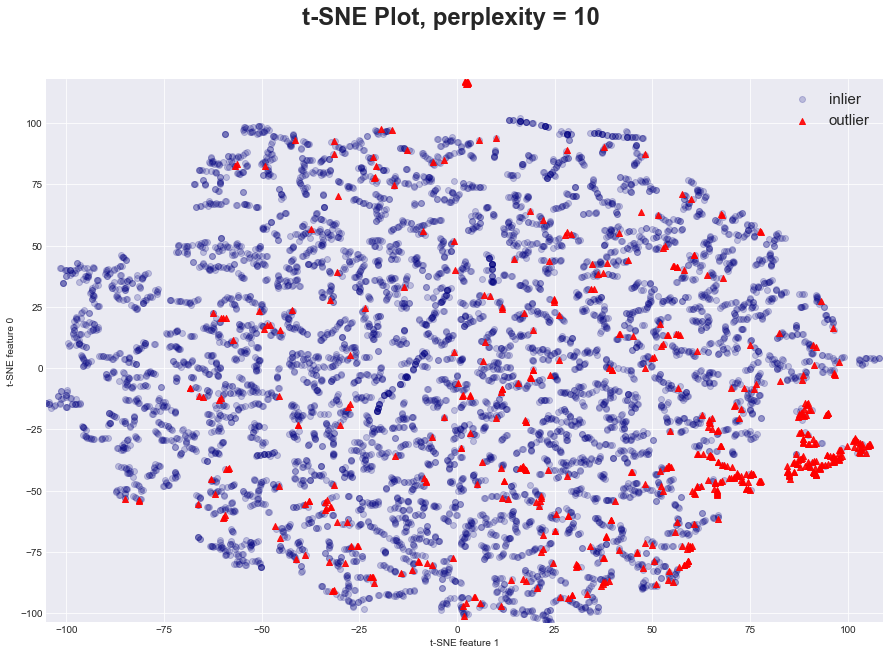

In [76]:
#plot with perplexity = 10
plt.figure(figsize=(15, 10))
plt.xlim(x_tsne_10[:, 0].min(), x_tsne_10[:, 0].max() + 1)
plt.ylim(x_tsne_10[:, 1].min(), x_tsne_10[:, 1].max() + 1)
plt.scatter(x_tsne_10[class_0_index,0],x_tsne_10[class_0_index,1],
            c='navy',marker='o',alpha=0.2,label = 'inlier')
plt.scatter(x_tsne_10[class_1_index,0],x_tsne_10[class_1_index,1],
            c='red',marker='^',alpha=0.9, label = 'outlier')
plt.ylabel("t-SNE feature 0")
plt.xlabel("t-SNE feature 1")
plt.suptitle('t-SNE Plot, perplexity = 10',fontsize=24,fontweight='bold')
plt.legend(prop={'size': 15})
plt.show()

In [44]:
#new perplexity(=100) for tsne
tsne_100 = TSNE(random_state=17,perplexity=100)
x_tsne_100 = tsne_100.fit_transform(data_x_scaled)

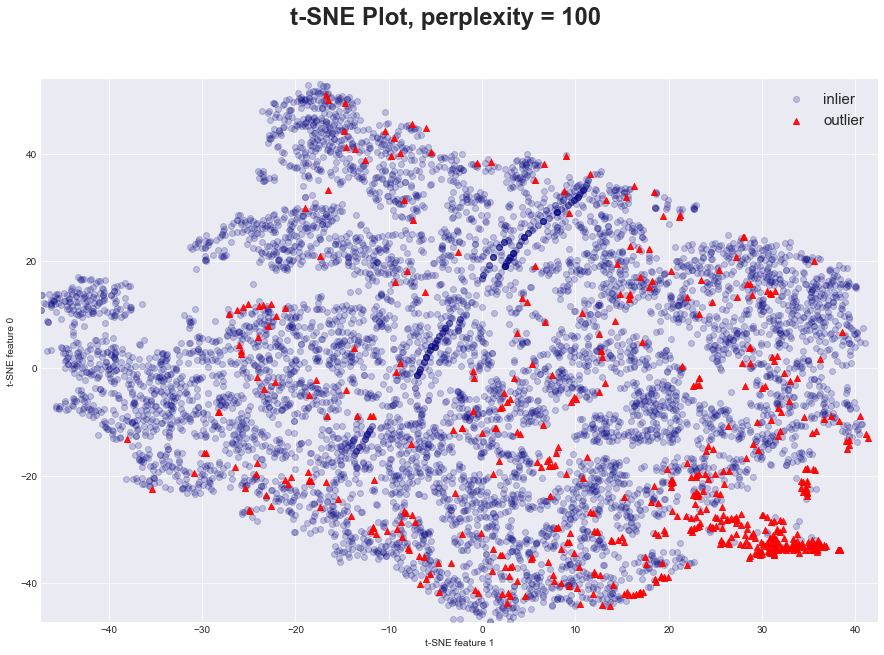

In [77]:
#plot with perplexity = 100
plt.figure(figsize=(15, 10))
plt.xlim(x_tsne_100[:, 0].min(), x_tsne_100[:, 0].max() + 1)
plt.ylim(x_tsne_100[:, 1].min(), x_tsne_100[:, 1].max() + 1)
plt.scatter(x_tsne_100[class_0_index,0],x_tsne_100[class_0_index,1],
            c='navy',marker='o',alpha=0.2,label='inlier')
plt.scatter(x_tsne_100[class_1_index,0],x_tsne_100[class_1_index,1],
            c='red',marker='^',alpha=0.9,label = 'outlier')
plt.ylabel("t-SNE feature 0")
plt.xlabel("t-SNE feature 1")
plt.suptitle('t-SNE Plot, perplexity = 100',fontsize=24,fontweight='bold')
plt.legend(prop={'size': 15})
plt.show()

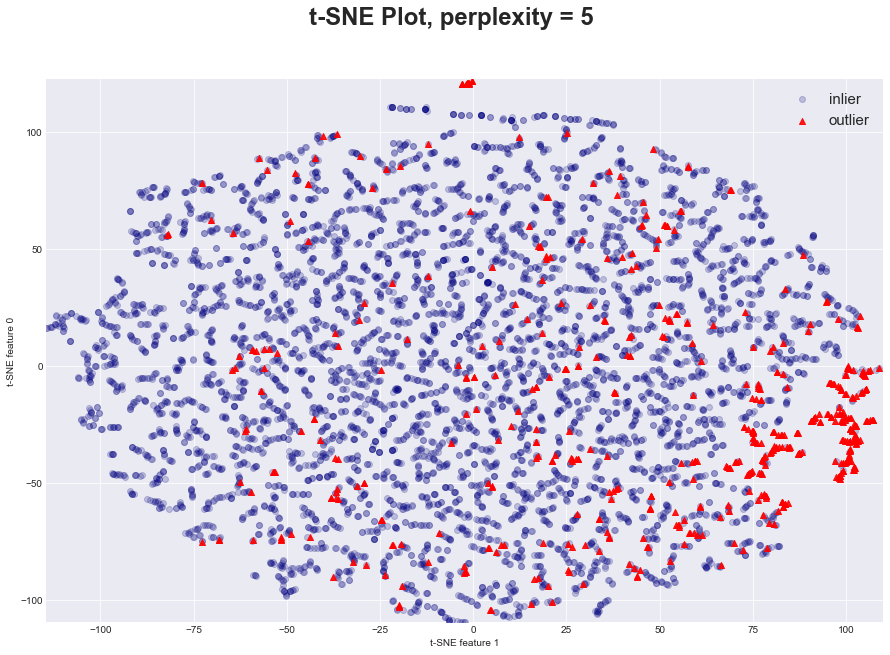

In [195]:
#plot with perplexity =1
tsne_5 = TSNE(random_state=17,perplexity=5)
x_tsne_5 = tsne_5.fit_transform(data_x_scaled)

plt.figure(figsize=(15, 10))
plt.xlim(x_tsne_5[:, 0].min(), x_tsne_5[:, 0].max() + 1)
plt.ylim(x_tsne_5[:, 1].min(), x_tsne_5[:, 1].max() + 1)
plt.scatter(x_tsne_5[class_0_index,0],x_tsne_5[class_0_index,1],
            c='navy',marker='o',alpha=0.2,label='inlier')
plt.scatter(x_tsne_5[class_1_index,0],x_tsne_5[class_1_index,1],
            c='red',marker='^',alpha=0.9,label='outlier')
plt.ylabel("t-SNE feature 0")
plt.xlabel("t-SNE feature 1")
plt.suptitle('t-SNE Plot, perplexity = 5',fontsize=24,fontweight='bold')
plt.legend(prop={'size': 15})
plt.show()


##### See if tuning the perplexity parameter helps obtaining a better visualization.

By changing the perplexity of tSNE, we observed that increasing the perplexity gradually improved the separation and the homogeneity of the clusters. 

Ex: For perplexity = 5, the red points get uniformly mixed into the blue region <br>
    For perplexity = 100, the red points are fairly separated from the blue region

# Task 2 Clustering (35Pts)
$2.1$ : Use KMeans, Agglomerative Clustering and DBSCAN to cluster the data. For each
algorithm, try to manually tune the parameters for a reasonable outcome and document how
you tuned the parameters. In particular pay attention to the sizes of the clusters created.
Create a dendrogram for agglomerative clustering (the truncate_mode='level' might be useful).
Manually inspect the outcomes as good as you can and identify if any of the resulting clusters
are semantically meaningful (as far as you can tell).


$2.2$ : Use the known ground truth labels of the outlier vs inlier class to evaluate your clustering
approaches using NMI and ARI scores. How well did they do? Can you adjust parameters so
they can detect the outliers better?

In [79]:
# data for model fitting
X = data_x_scaled
X_pca_2 = data_x_scaled_pca
y = data_y.flatten()

## Task 2.1

### Clustering with Kmeans

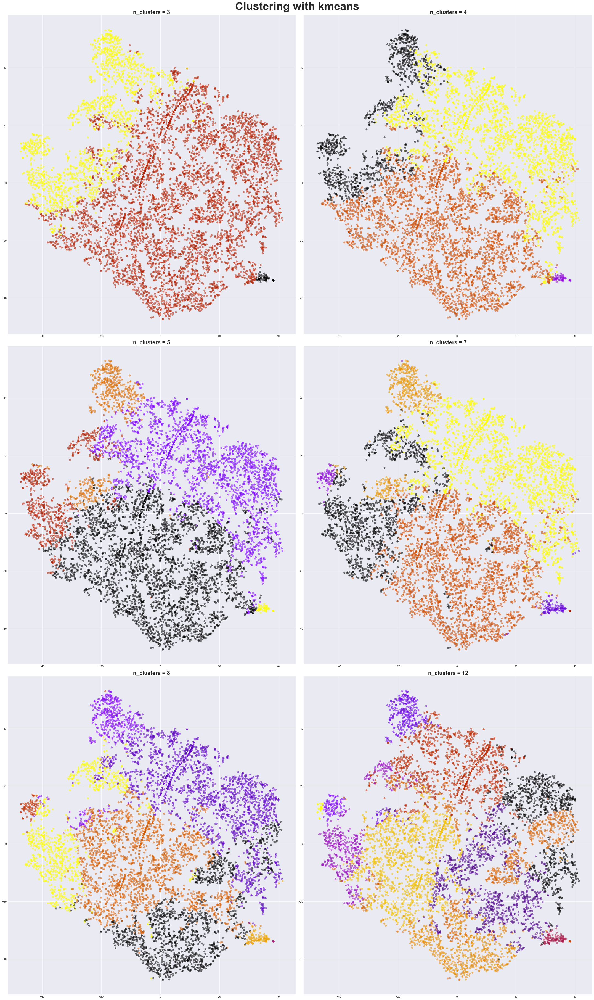

In [304]:
##Use KMeans to cluster the data

fig, axes = plt.subplots(3,2,figsize=(30,50))
ax = axes.ravel()
n_clusters_param = [3,4,5,7,8,12]
kmeans_cluster_count_df = pd.DataFrame(
    columns = ['n_clusters','labels','counts'])
for n,axis in zip(n_clusters_param,ax):
    kmeans = cluster.KMeans(n_clusters=n,random_state=17)
    kmeans.fit(X)
    labels = kmeans.predict(X)
    label, counts = np.unique(labels, return_counts=True)
    new_cluster_df = pd.DataFrame(list(zip([n]*n,label, counts)),
                                  columns = ['n_clusters','labels','counts'])
    kmeans_cluster_count_df = pd.concat([kmeans_cluster_count_df,
                                         new_cluster_df])
#     #axis.scatter(x_tsne_100[class_0_index,0],x_tsne_100[class_0_index,1],
#                  marker='+',c = labels[class_0_index],label='inliers',
#                  alpha=0.5,cmap = 'gnuplot')
    axis.scatter(x_tsne_100[:,0],x_tsne_100[:,1],
                 marker='o',c = labels,
                 alpha=0.5,cmap = 'gnuplot')
    axis.set_title("n_clusters = %d" %n,
                   fontdict = {'fontsize':20, 'fontweight':'bold'})
    #axis.legend()
plt.suptitle("Clustering with kmeans",y=1.005,fontsize=40,
             fontweight='bold')
plt.tight_layout()
plt.show()


In [220]:
#Making a DF with size of individual clusters formed by varing the n_clusters
kmeans_cluster_count_df = kmeans_cluster_count_df.sort_values(
    by=['n_clusters','counts'],ascending=False)
print(kmeans_cluster_count_df[kmeans_cluster_count_df.n_clusters == 7])

  n_clusters labels counts
4          7      4   2821
6          7      6   2297
0          7      0   1308
5          7      5    551
1          7      1    120
2          7      2     92
3          7      3     11


###### Silhouette Analysis of n_clusters for KMeans :

For n_clusters = 3 The average silhouette_score is : 0.2771359492295681
For n_clusters = 4 The average silhouette_score is : 0.21435822862157786
For n_clusters = 5 The average silhouette_score is : 0.2335355596170837
For n_clusters = 7 The average silhouette_score is : 0.23532534281222411
For n_clusters = 8 The average silhouette_score is : 0.2214108123429336
For n_clusters = 12 The average silhouette_score is : 0.17448771597200605


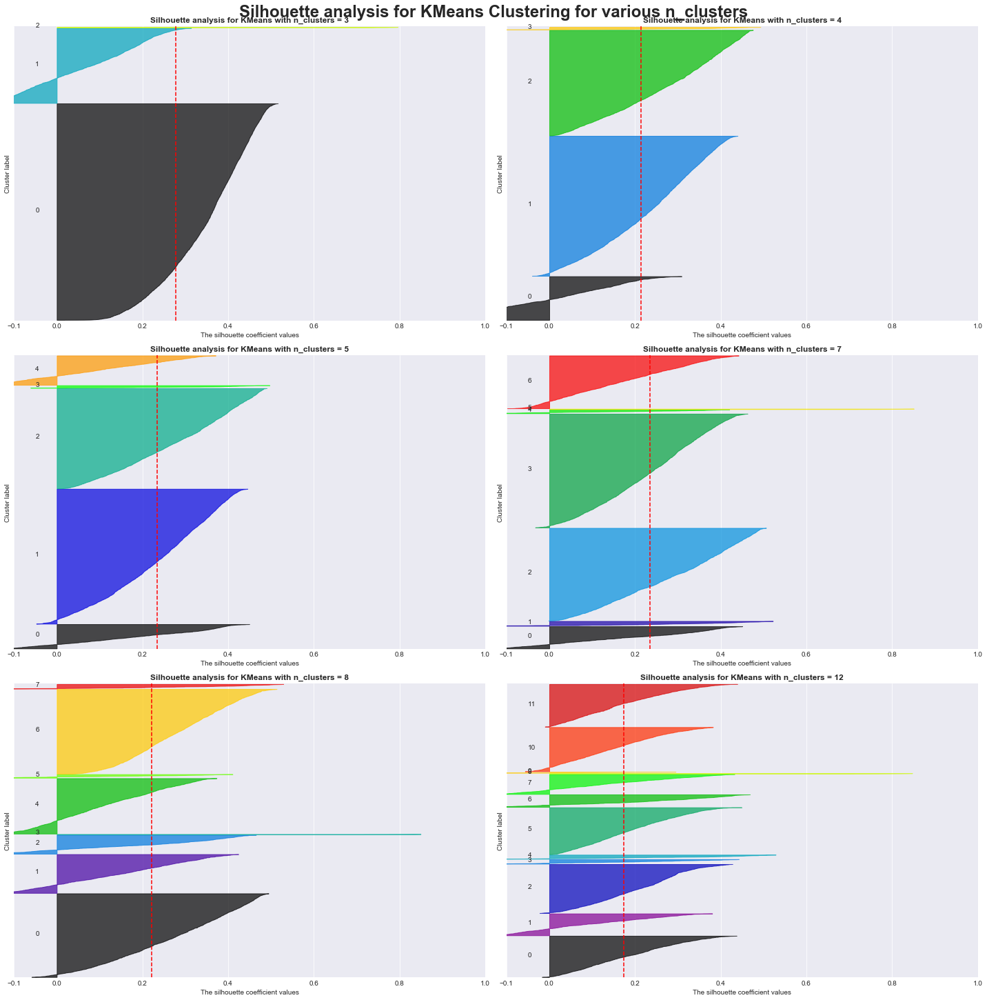

In [143]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
range_n_clusters = [3,4,5,7,8,12]
fig, axes = plt.subplots(3, 2)
ax = axes.ravel()
fig.set_size_inches(20, 20)
k = 0

for n_clusters in range_n_clusters:
    ax1 = ax[k]
    k+= 1
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    ax1.set_title(("Silhouette analysis for KMeans "
                  "with n_clusters = %d" % n_clusters),
                 fontdict = {'fontsize':12, 'fontweight':'bold'})
plt.suptitle("Silhouette analysis for KMeans Clustering for various n_clusters",y = 1.005, fontsize=24,fontweight='bold')
plt.tight_layout()
plt.show()

##### * For each algorithm, try to manually tune the parameters for a reasonable outcome and document how you tuned the parameters.

* We tried to manually search through parameters and visualized the clusters. The clusters do not revel much information from visual inspection.

* We tried to check the sizes of the clusters formed below above to find a pattern. <br>
  n_clusters=7 seemd to have a reasonable distribution of data points

* By looking at the Silhouette scores, we can say that **n_clusters =7 or 8** form well defined clusters <br>
  compared to other cluster sizes

### Clustering with Agglomerative Clustering 

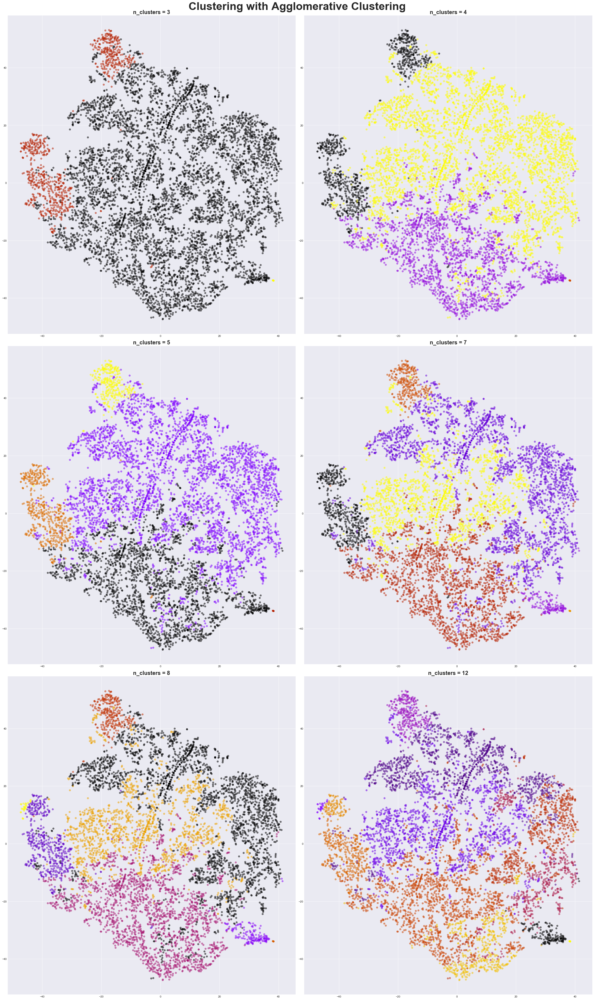

In [306]:
##Use agglomerative Clustering 
from sklearn.cluster import AgglomerativeClustering
fig, axes = plt.subplots(3,2,figsize=(30,50))
ax = axes.ravel()

n_clusters_param = [3,4,5,7,8,12]
agg_cluster_counts_df = pd.DataFrame(
    columns = ['n_clusters','labels','counts'])

for n,axis in zip(n_clusters_param,ax):
    agg_clusters = AgglomerativeClustering(
        n_clusters=n, linkage='ward')
    labels_agg = agg_clusters.fit_predict(X)
    label, counts = np.unique(labels_agg, return_counts=True)
    new_cluster_df = pd.DataFrame(list(zip([n]*n,label, counts)),
                                  columns = ['n_clusters','labels','counts'])
    agg_cluster_counts_df = pd.concat([agg_cluster_counts_df,new_cluster_df])
    axis.scatter(x_tsne_100[:,0],x_tsne_100[:,1],
                 marker='o',c = labels_agg,
                 alpha=0.5,cmap = 'gnuplot')
#     axis.scatter(x_tsne_100[class_1_index,0],x_tsne_100[class_1_index,1],
#                  marker='o',c = labels_agg[class_1_index],label='outliers',
#                  alpha=0.9,cmap = 'gnuplot')
    axis.set_title("n_clusters = %d" %n,
                   fontdict = {'fontsize':20, 'fontweight':'bold'})
    
plt.suptitle("Clustering with Agglomerative Clustering",
             y=1.005,fontsize=40,fontweight='bold')
plt.tight_layout()
plt.show()

In [225]:
agg_cluster_counts_df = agg_cluster_counts_df.sort_values(
    by=['n_clusters','counts'],ascending=False)
print(agg_cluster_counts_df[agg_cluster_counts_df.n_clusters == 7])

  n_clusters labels counts
1          7      1   2649
3          7      3   1997
6          7      6   1555
0          7      0    529
4          7      4    293
2          7      2    166
5          7      5     11


### Dendogram for Agglomerative Clustering ; Linkage = 'ward'

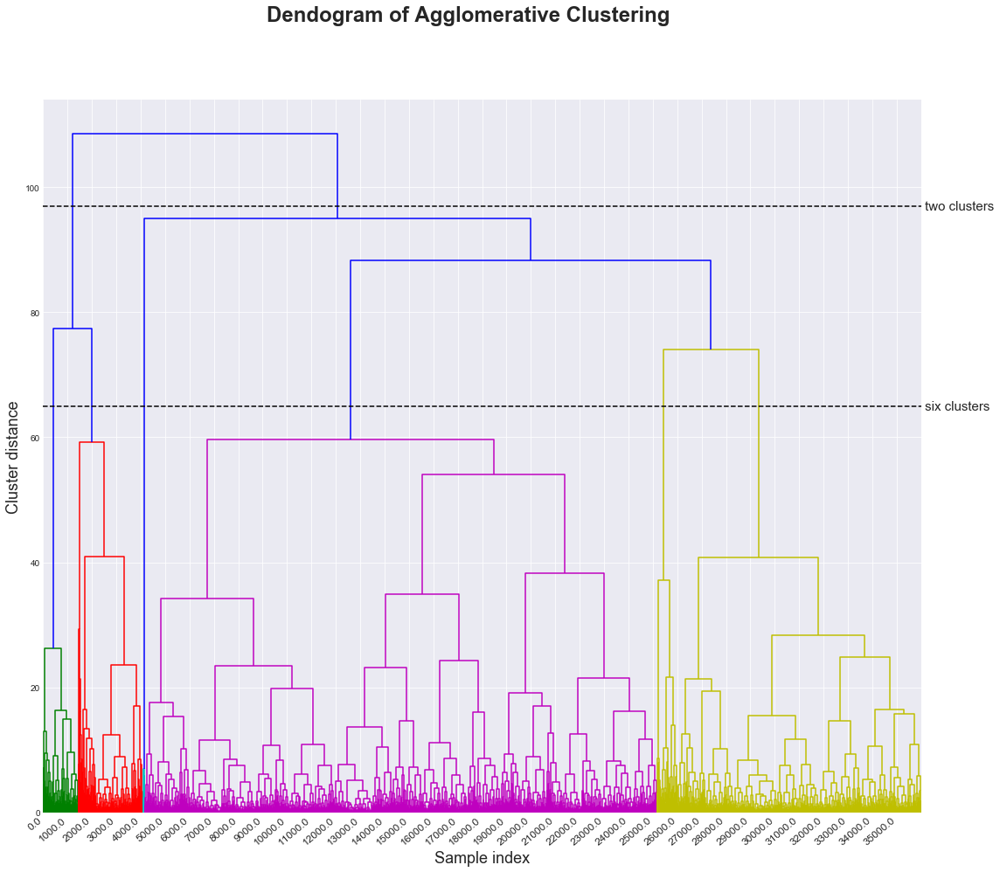

In [34]:
## Plot dendogram of agglomerative clustering
from scipy.cluster.hierarchy import ward,dendrogram

cluster_linkage = ward(X)
fig,ax = plt.subplots(1,1,figsize=(18,15))

dendrogram(cluster_linkage,truncate_mode='level')

# Marking the cuts in the tree that signify two or three clusters

ax = plt.gca()
bounds = ax.get_xbound()
ax.plot(bounds, [97, 97], '--', c='k')
ax.plot(bounds, [65, 65], '--', c='k')
ax.text(bounds[1], 97, ' two clusters', va='center',
        fontdict={'size': 15})
ax.text(bounds[1], 65, ' six clusters', va='center',
        fontdict={'size': 15})
xlabel_positions = np.arange(bounds[0],bounds[1],2000)
xlabels = np.arange(bounds[0],bounds[1],1000)
ax.set_xticks(xlabel_positions)
ax.set_xticklabels(xlabels,rotation = 40, ha='right',
                   fontdict={'fontsize': 12})
plt.xlabel("Sample index",fontsize = 18)
plt.ylabel("Cluster distance",fontsize = 18)
plt.suptitle("Dendogram of Agglomerative Clustering",
             fontsize = 24, fontweight = 'bold')
plt.show()

##### For each algorithm, try to manually tune the parameters for a reasonable outcome and document how you tuned the parameters

* We manually searched for the paramters and plotted the clusters. 
* We viewed the cluster sizes formed for each n_cluster parameter
* Using the dendogram, we could see that at the level of 6 clusters in the graph, the vertical lines (that       denote distance between 2 clusters being merged) are relatively short. Implying that the clusters merged upto 6 clusters are not too far. Any mergers after the 6 clusters would cause forceful merging of distant clusters

Through manual unsupervised inspection it seems, **n_clusters = 6** does a decent clustering

### Clustering with DBSCAN

In [111]:
##Use DBSCAN for clustering : Parmeters = Default

from sklearn.cluster import DBSCAN

dbs_clusters = DBSCAN()
labels_dbs = dbs_clusters.fit_predict(X)
label_dbs, counts_dbs = np.unique(labels_dbs, return_counts=True)
n_clusters = label_dbs.shape[0]
    

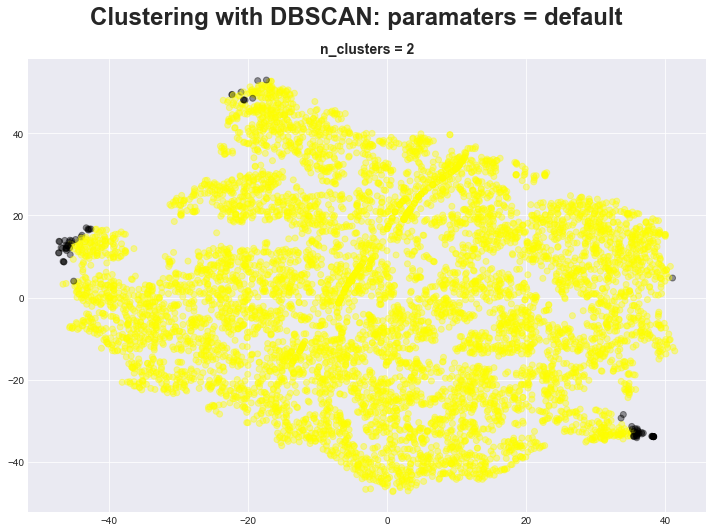

In [308]:
fig,axis = plt.subplots(1,1,figsize = (10,7))
# axis.scatter(x_tsne_100[class_0_index,0],x_tsne_100[class_0_index,1],
#              marker='+',c = labels_dbs[class_0_index],label='inliers',
#              alpha=0.5,cmap = 'gnuplot')
axis.scatter(x_tsne_100[:,0],x_tsne_100[:,1],
             marker='o',c = labels_dbs,
             alpha=0.4,cmap = 'gnuplot')
axis.set_title("n_clusters = %d" %n_clusters,
               fontdict = {'fontsize':14, 'fontweight':'bold'})
plt.suptitle("Clustering with DBSCAN: paramaters = default",
             y=1.05,fontsize=24,fontweight='bold')
plt.tight_layout()
plt.show()    

In [296]:
print("The default clustering parameters of DBSCAN are {}".format(
    dbs_clusters.get_params()))

The default clustering parameters of DBSCAN are {'leaf_size': 30, 'min_samples': 15, 'metric_params': None, 'algorithm': 'auto', 'n_jobs': 1, 'p': None, 'metric': 'euclidean', 'eps': 2}


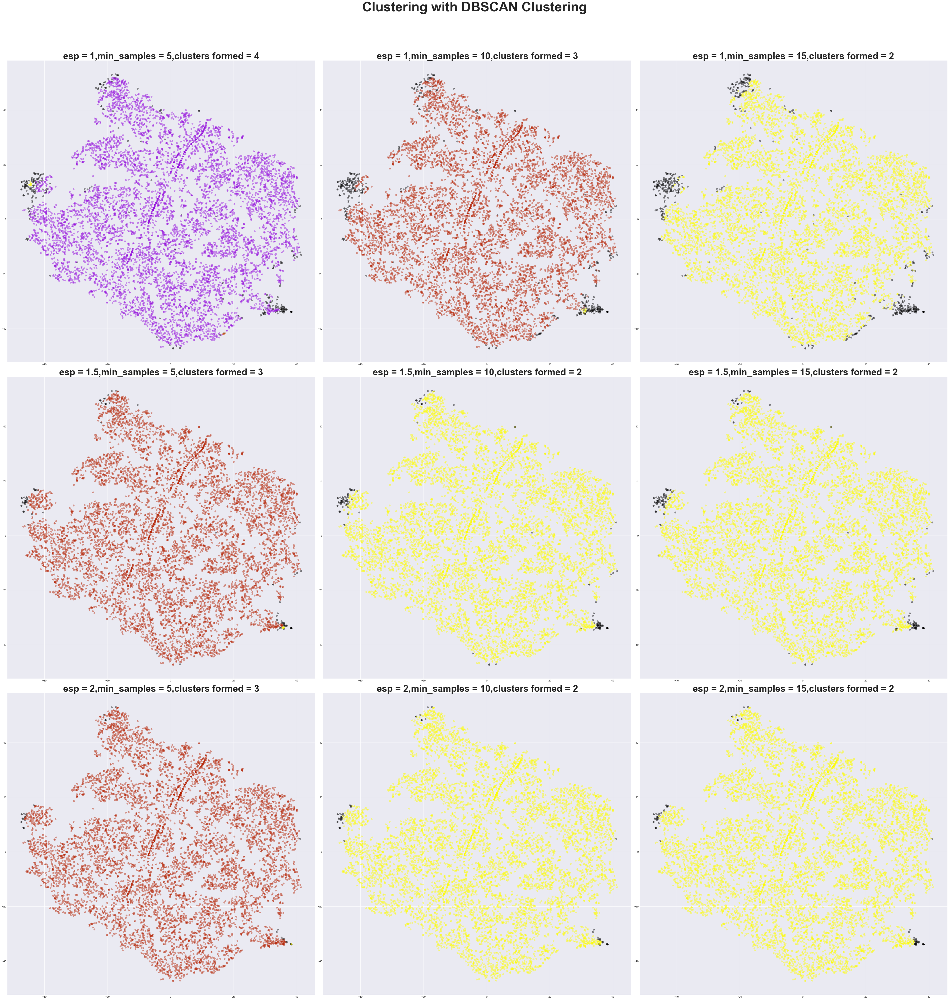

In [309]:
##Use DBSCAN for clustering : Parmeters = variable

from sklearn.cluster import DBSCAN

fig, axes = plt.subplots(3,3,figsize=(50,50))
ax = axes.ravel()

dbs_cluster_count_df = pd.DataFrame(
    columns = ['n_clusters','labels','counts','params'])

eps_param = [1, 1.5, 2]
min_samples_param = [5,10,15]
eps_min_samples_combo = [(x, y) for x in eps_param for y in min_samples_param]

for (e,m),axis in zip(eps_min_samples_combo,ax):
    dbs_clusters = DBSCAN(eps = e,min_samples=m)
    labels_dbs = dbs_clusters.fit_predict(X)
    label_dbs, counts_dbs = np.unique(labels_dbs, return_counts=True)
    n_clusters = label_dbs.shape[0]
    new_cluster_df = pd.DataFrame(list(zip([n_clusters]*n_clusters,
                                           label_dbs, counts_dbs,
                                           [(e,m)]*n_clusters)),
                                  columns = ['n_clusters','labels','counts','params'])
    dbs_cluster_count_df = pd.concat([dbs_cluster_count_df,new_cluster_df])
#     axis.scatter(x_tsne_100[class_0_index,0],x_tsne_100[class_0_index,1],
#                  marker='+',c = labels_dbs[class_0_index],label='inliers',
#                  alpha=0.5,cmap = 'gnuplot')
    axis.scatter(x_tsne_100[:,0],x_tsne_100[:,1],
                 marker='o',c = labels_dbs,
                 alpha=0.4,cmap = 'gnuplot')
    axis.set_title("esp = {},min_samples = {},clusters formed = {}".format(e,m,n_clusters),
                   fontdict = {'fontsize':35, 'fontweight':'bold'})
    
plt.suptitle("Clustering with DBSCAN Clustering",y=1.05,fontsize=50,fontweight='bold')
plt.tight_layout()
plt.show()

In [232]:
dbs_cluster_count_df = dbs_cluster_count_df.sort_values(
    by = ['params','n_clusters','labels'])
dbs_cluster_count_df

,n_clusters,labels,counts,params
0,4,-1,277,"(1, 5)"
1,4,0,6912,"(1, 5)"
2,4,1,4,"(1, 5)"
3,4,2,7,"(1, 5)"
0,3,-1,390,"(1, 10)"
1,3,0,6801,"(1, 10)"
2,3,1,9,"(1, 10)"
0,2,-1,491,"(1, 15)"
1,2,0,6709,"(1, 15)"
0,3,-1,95,"(1.5, 5)"


In [263]:
dbs_cluster_outlier_ratios = dbs_cluster_count_df.copy(deep=True)
dbs_cluster_outlier_ratios.loc[dbs_cluster_outlier_ratios['labels'] >= 0, 'labels'] = 50
dbs_cluster_outlier_ratios_grp = dbs_cluster_outlier_ratios.groupby(by = ['params','labels'])
print("The ratio of outliers (-1) to inliers (50) for different parameter settings of DBSCAN:")
dbs_cluster_outlier_ratios_grp['counts'].sum()/7200
#dbs_cluster_outlier_ratios.groupby(by='params')['counts'].sum()

The ratio of outliers (-1) to inliers (50) for different parameter settings of DBSCAN:


params     labels
(1, 5)     -1        0.038472
            50       0.961528
(1, 10)    -1        0.054167
            50       0.945833
(1, 15)    -1        0.068194
            50       0.931806
(1.5, 5)   -1        0.013194
            50       0.986806
(1.5, 10)  -1        0.018889
            50       0.981111
(1.5, 15)  -1        0.021944
            50       0.978056
(2, 5)     -1        0.005000
            50       0.995000
(2, 10)    -1        0.008611
            50       0.991389
(2, 15)    -1        0.010833
            50       0.989167
Name: counts, dtype: float64

##### For each algorithm, try to manually tune the parameters for a reasonable outcome and document how you tuned the parameters.

* We manually searched for parameters eps and min_samples and visualized the clusters formed 
* We looked at the ratios of outliers to inliers labelled by DBSCAN 
* We looked at the size of the clusters created for different parameter settings 

eps=1 and min_samples = 15 (number of clusters formed = 2) had resonably good output in the visualization plots

## Task 2.2 
Use the known ground truth labels of the outlier vs inlier class to evaluate your clustering approaches using NMI and ARI scores. How well did they do? Can you adjust parameters so they can detect the outliers better?**

### Kmeans evaluation using NMI,ARI

In [122]:
## Use ARI, NMI to evaluate models
#Kmeans
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.metrics.cluster import normalized_mutual_info_score

n_clusters_param = [3,4,5,7,8,12]
kmeans_cluster_scores = pd.DataFrame(columns=['n_clusters','ARI Score','NMI Score'])
for n in n_clusters_param:
    kmeans = cluster.KMeans(n_clusters=n,random_state=17)
    kmeans.fit(X)
    y_pred = kmeans.predict(X)
    ari = adjusted_rand_score(y,y_pred)
    nmi = normalized_mutual_info_score(y,y_pred)
    row_dict = {'n_clusters':n,'ARI Score':ari, 'NMI Score':nmi}
    kmeans_cluster_scores = kmeans_cluster_scores.append(
        row_dict,ignore_index = True)


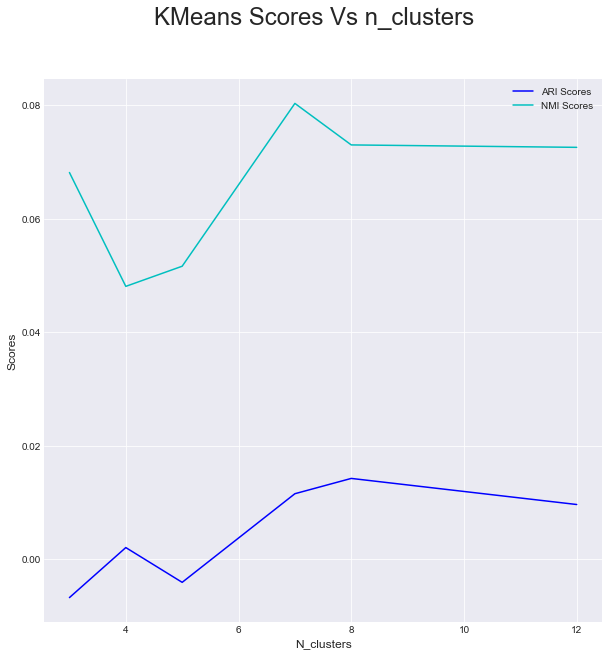

In [123]:
fig, ax = plt.subplots(1,1,figsize= (10,10))
sns.set_style('darkgrid')
#sns.set_palette("husl")
ax.plot(kmeans_cluster_scores['n_clusters'],kmeans_cluster_scores['ARI Score'],
        label='ARI Scores',c='b')
ax.plot(kmeans_cluster_scores['n_clusters'],kmeans_cluster_scores['NMI Score'],
        label='NMI Scores',c='c')
ax.set_xlabel('N_clusters',fontsize = 12)
ax.set_ylabel('Scores',fontsize = 12)
plt.legend()
plt.suptitle('KMeans Scores Vs n_clusters',fontsize=24)
plt.show()

##### Use the known ground truth labels of the outlier vs inlier class to evaluate your clustering approaches using NMI and ARI scores.

* The NMI and ARI plots have a peak at **n_clusters = 7**
* This outcome is consistent with what we manually found out without ground truth labels. It implies that the clustering model outcome was fairly consistent with the data distribution with ground truth labels

### Agglomerative Clustering evaluation using NMI, ARI

In [124]:
## Use ARI, NMI to evaluate models
#Agglomerative Clustering
n_clusters_param = [3,4,5,7,8,12]
agg_cluster_scores = pd.DataFrame(columns=['n_clusters','ARI Score','NMI Score'])
for n in n_clusters_param:
    agg = cluster.AgglomerativeClustering(n_clusters=n)
    #agg.fit(X)
    y_pred = agg.fit_predict(X)
    ari = adjusted_rand_score(y,y_pred)
    nmi = normalized_mutual_info_score(y,y_pred)
    row_dict = {'n_clusters':n,'ARI Score':ari, 'NMI Score':nmi}
    agg_cluster_scores = agg_cluster_scores.append(row_dict,
                                                   ignore_index = True)


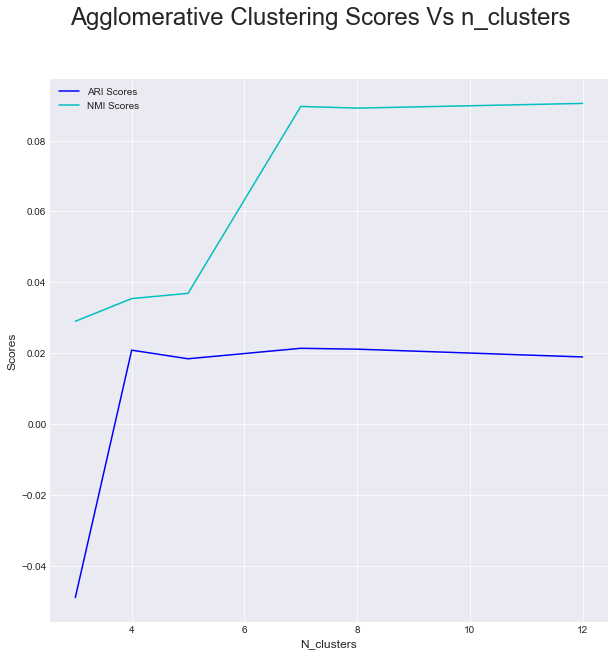

In [125]:
fig, ax = plt.subplots(1,1,figsize= (10,10))
sns.set_style('darkgrid')
#sns.set_palette("husl")
ax.plot(agg_cluster_scores['n_clusters'],agg_cluster_scores['ARI Score'],
        label='ARI Scores',c='b')
ax.plot(agg_cluster_scores['n_clusters'],agg_cluster_scores['NMI Score'],
        label='NMI Scores',c='c')
ax.set_xlabel('N_clusters',fontsize = 12)
ax.set_ylabel('Scores',fontsize = 12)
plt.legend()
plt.suptitle('Agglomerative Clustering Scores Vs n_clusters',fontsize=24)
plt.show()

##### Use the known ground truth labels of the outlier vs inlier class to evaluate your clustering approaches using NMI and ARI scores.

* The NMI and ARI plots have a peak at **n_clusters = 7**
* From our observation of the Dendogram we had concluded that n_clusters should be 6. It implies that the clustering model outcome likely slightly differs from the data distribution with ground truth labels

### DBSCAN evaluation using NMI, ARI

In [264]:
#DBSCAN evaluation using NMI, ARI

eps_param = [1, 1.5, 2]
min_samples_param = [5,10,15]
eps_min_samples_combo = [(x, y) for x in eps_param for y in min_samples_param]
dbs_cluster_scores = pd.DataFrame(columns=['params','ARI Score','NMI Score'])
for (e,m) in eps_min_samples_combo:
    dbs_clusters = DBSCAN(eps = e,min_samples=m)
    labels_dbs = dbs_clusters.fit_predict(X)
    label_dbs, counts_dbs = np.unique(labels_dbs, return_counts=True)
    n_clusters = label_dbs.shape[0]
    y_pred = labels_dbs
    ari = adjusted_rand_score(y,y_pred)
    nmi = normalized_mutual_info_score(y,y_pred)
    row_dict = {'params':(e,m),'ARI Score':ari, 'NMI Score':nmi}
    dbs_cluster_scores = dbs_cluster_scores.append(row_dict,ignore_index = True)


In [265]:
dbs_cluster_scores = dbs_cluster_scores.sort_values(by='params')

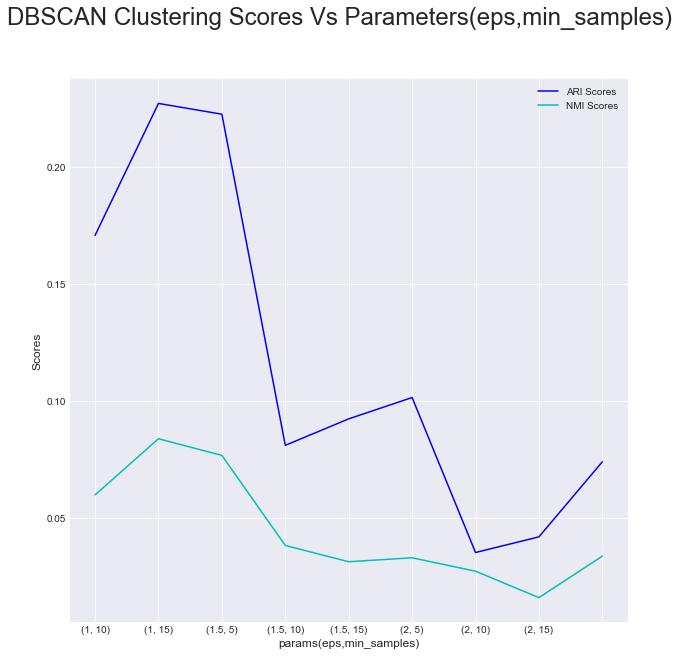

In [269]:
fig, ax = plt.subplots(1,1,figsize= (10,10))
sns.set_style('darkgrid')
ax.plot(range(dbs_cluster_scores.shape[0]),dbs_cluster_scores['ARI Score'],
        label='ARI Scores',c='b')
ax.plot(range(dbs_cluster_scores.shape[0]),dbs_cluster_scores['NMI Score'],
        label='NMI Scores',c='c')
ax.set_xticklabels(dbs_cluster_scores['params'])
ax.set_xlabel('params(eps,min_samples)',fontsize = 12)
ax.set_ylabel('Scores',fontsize = 12)
plt.legend()
plt.suptitle('DBSCAN Clustering Scores Vs Parameters(eps,min_samples)',
             fontsize=24)
plt.show()

##### Use the known ground truth labels of the outlier vs inlier class to evaluate your clustering approaches using NMI and ARI scores.

* The NMI and ARI plots have a peak at **eps=1,min_samples = 15**
* From our observation of the plots of DBSCAN we had concluded that the optimal parameters for clustering should be (1,15) which is consistent with the outcome of supervised evaluation. It implies that the clustering model outcome likely consistent with the data distribution with ground truth labels

### TODO:How well did they do? Can you adjust parameters so they can detect the outliers better?

##### Kmeans:
* The NMI and ARI plots have a peak at **n_clusters = 7**
* This outcome is consistent with what we manually found out without ground truth labels. It implies that the clustering model outcome was fairly consistent with the data distribution with ground truth labels

##### Agglomerative Clustering:
* The NMI and ARI plots have a peak at **n_clusters = 7**
* From our observation of the Dendogram we had concluded that n_clusters should be 6. It implies that the clustering model outcome likely slightly differs from the data distribution with ground truth labels

##### DBSCAN Clustering:
* The NMI and ARI plots have a peak at **eps=1,min_samples = 15**
* From our observation of the plots of DBSCAN we had concluded that the optimal parameters for clustering should be (1,15) which is consistent with the outcome of supervised evaluation. It implies that the clustering model outcome likely consistent with the data distribution with ground truth labels

<br>
**It implies that the following parameter settings provide nearly accurate results for detecting outliers:**<br>
* n_clusters = 7 (Kmeans, agglomerative Clustering)<br>
* eps = 1, min_samples = 15 (DBSCAN)<br>

# Task 3 Outlier Detection (35Pts)
3.1 Assume that you know the proportion of outliers (FIXME%). Use EllipticEnvelope,
OneClassSVM and IsolationForest to detect outliers. Without using the ground-truth, can you
tell which one gave the best results? Why?

3.2 Use the ground-truth to evaluate the different outlier detection approaches using AUC and
average precision. How can you compare their quality to the clustering approaches from Task
1?

## 3.1 Assume that you know the proportion of outliers (FIXME%). 
Use EllipticEnvelope,OneClassSVM and IsolationForest to detect outliers. Without using the ground-truth, can you
tell which one gave the best results? Why?

##### proportion of outliers (known % of outliers):

In [136]:
label_ratios = data_df['y'].value_counts()/data_df.shape[0]
prop_outliers = label_ratios[1]
print("The known (%) of outliers is {}".format(prop_outliers))

The known (%) of outliers is 0.07416666666666667


### EllpiticEnvelope:

In [205]:
#Use EllpiticEnvelope to detect outliers
from sklearn.covariance import EllipticEnvelope

ellenv = EllipticEnvelope(contamination=prop_outliers)
ellenv.fit(X)
y_ellenv = ellenv.predict(X)

In [206]:
y_ellenv[y_ellenv == -1] = 2
y_ellenv[y_ellenv == 1] = 0
y_ellenv[y_ellenv == 2] = 1

In [276]:
print("inliers counts of Elliptic Envelope are:",
      np.unique(y_ellenv,return_counts=True)[1][0])
print("outliers counts of Elliptic Envelope are:", 
      np.unique(y_ellenv, return_counts=True)[1][1])

inliers counts of Elliptic Envelope are: 6666
outliers counts of Elliptic Envelope are: 534


### OneClassSVM

In [209]:
#Use OneClassSVM to detect outliers
from sklearn.svm import OneClassSVM

ocs = OneClassSVM(nu=prop_outliers)
ocs.fit(X)
y_ocs = ocs.predict(X)


In [210]:
y_ocs[y_ocs == -1] = 2
y_ocs[y_ocs == 1] = 0
y_ocs[y_ocs == 2] = 1

In [277]:
print("inliers counts of OneClassSVM are:",
      np.unique(y_ocs, return_counts=True)[1][0])
print("outliers counts of OneClassSVM are:", 
      np.unique(y_ocs, return_counts=True)[1][1])

inliers counts of OneClassSVM are: 6663
outliers counts of OneClassSVM are: 537


### IsolationForest

In [213]:
#Use IsolationForest to detect outliers
from sklearn.ensemble import IsolationForest

isf = IsolationForest(contamination=prop_outliers)
isf.fit(X)
y_isf = isf.predict(X)

In [214]:
y_isf[y_isf == -1] = 2
y_isf[y_isf == 1] = 0
y_isf[y_isf == 2] = 1

In [278]:
print("inliers counts of IsolationForest are:",
      np.unique(y_isf, return_counts=True)[1][0])
print("outliers counts of IsolationForest are:",
      np.unique(y_isf, return_counts=True)[1][1])

inliers counts of IsolationForest are: 6666
outliers counts of IsolationForest are: 534


### Comparison of the three outlier detection models without ground truth labels:

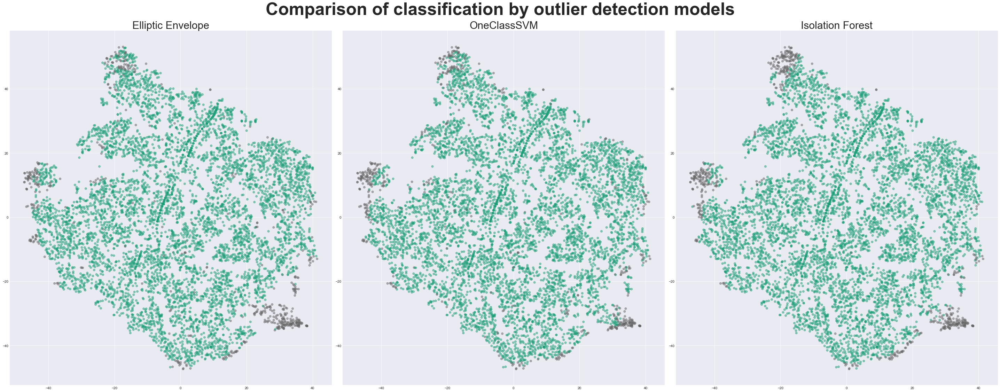

In [311]:
fig, axes = plt.subplots(1,3,figsize=(40,15))

# axes[0].scatter(x_tsne_100[class_0_index,0],x_tsne_100[class_0_index,1],
#                 marker='+',c=y_ellenv[class_0_index],cmap='Dark2')
axes[0].scatter(x_tsne_100[:,0],x_tsne_100[:,1],alpha = 0.5,
                marker='o',c=y_ellenv,cmap='Dark2')
axes[0].set_title('Elliptic Envelope',fontsize=30)

# axes[1].scatter(x_tsne_100[class_0_index,0],x_tsne_100[class_0_index,1],
#                 marker='+',c=y_ocs[class_0_index],cmap='Dark2')
axes[1].scatter(x_tsne_100[:,0],x_tsne_100[:,1],alpha = 0.5,
                marker='o',c=y_ocs,cmap='Dark2')
axes[1].set_title('OneClassSVM',fontsize=30)

# axes[2].scatter(x_tsne_100[class_0_index,0],x_tsne_100[class_0_index,1],
#                 marker='+',c=y_isf[class_0_index],cmap='Dark2')
axes[2].scatter(x_tsne_100[:,0],x_tsne_100[:,1],alpha = 0.5,
                marker='o',c=y_isf,cmap='Dark2')
axes[2].set_title('Isolation Forest',fontsize=30)

plt.suptitle('Comparison of classification by outlier detection models',
             y=1.04,fontsize=50,fontweight='bold')
plt.tight_layout()
plt.show()

##### Without using the ground-truth, can you tell which one gave the best results? Why?

* From the outlier counts of the three models we cannot conclude much as the results are very similar
* From the 3 plots above, we see that **IsolationForests** have a very clean separation of the distribution from the outliers. The ditribution is not too contaminated with outliers (grey)

## Task 3.2
Use the ground-truth to evaluate the different outlier detection approaches using AUC and average precision. How can you compare their quality to the clustering approaches from Task1?

#### EllipticEnvelope Performance Metrics:

In [208]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import average_precision_score
auc = roc_auc_score(y, y_ellenv)
print("AUC score of EllipticEnvelope is {} ".format(auc))
avg_prec = average_precision_score(y, y_ellenv, average='macro',
                                   sample_weight=None)
print("Average Precision score of EllipticEnvelope is {} ".format(avg_prec))


AUC score of EllipticEnvelope is 0.7077235813468987 
Average Precision score of EllipticEnvelope is 0.25063770357278126 


#### OneClassSVM Performance Metrics:

In [212]:
auc = roc_auc_score(y, y_ocs)
print("AUC score of OneClassSVM is {} ".format(auc))
avg_prec = average_precision_score(y, y_ocs, average='macro',
                                   sample_weight=None)
print("Average Precision score of OneClassSVM is {} ".format(avg_prec))

AUC score of OneClassSVM is 0.5841154340153115 
Average Precision score of OneClassSVM is 0.10984210553846799 


#### IsolationForest Performance Metrics:

In [216]:
auc = roc_auc_score(y, y_isf)
print("AUC score of IsolationForest is {} ".format(auc))
avg_prec = average_precision_score(y, y_isf, average='macro',
                                   sample_weight=None)
print("Average Precision score of IsolationForest is {} ".format(avg_prec))

AUC score of IsolationForest is 0.6338959738670495 
Average Precision score of IsolationForest is 0.15402449887079356 


#### How can you compare their quality to the clustering approaches from Task1?

Computing the AUC  and average precision scores of DBSCAN with best params:

In [284]:
##Use DBSCAN for clustering with best Parmeters
dbs_clusters_best = DBSCAN(eps=1,min_samples=15)
labels_dbs_best = dbs_clusters_best.fit_predict(X)

In [286]:
labels_dbs_best[labels_dbs_best == -1] = 1

In [288]:
auc = roc_auc_score(y, labels_dbs_best)
print("AUC score of DBSCAN is {} ".format(auc))
avg_prec = average_precision_score(y, labels_dbs_best, average='macro',
                                   sample_weight=None)
print("Average Precision score of DBSCAN is {} ".format(avg_prec))

AUC score of DBSCAN is 0.620939902979062 
Average Precision score of DBSCAN is 0.14531676926245451 


We did not compare KMeans and Agglomerative with outliers detection approaches as it would be difficult to label which points are outliers among multiple cluster labels. In DBSCAN model, it returns the outliers as labelled '-1' hence we can compare its outcome with the other outlier detection models.

Comparison of DBSCAN with other outlier detection models:

1. DBSCAN is better than OneClassSVM in detecting outlier
2. IsolationForest and EllipticEnvelope performed better than DBSCAN

# Task 4 Imbalanced Classification (10Pts)
Threat the problem as an imbalanced classification problem using LogisticRegression and
RandomForestClassifier. Compare your results with the outlier detection in terms of AUC and
average precision. Tune C and a regularization mechanism for the random forest. Does
changing the class-weight to “balanced” help?

### Test Train Split:

In [290]:
#train test split
from sklearn.model_selection import train_test_split as sksplit
from sklearn.model_selection import cross_val_score, GridSearchCV

X_train,X_test,y_train,y_test = sksplit(X,y,stratify=y)

### Fitting Logistic Regression

##### Default Parameters:

In [317]:
#fit logistic regression
from sklearn import linear_model
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import average_precision_score,roc_auc_score,make_scorer
aps = make_scorer(average_precision_score)

param_grid = {'C': [0.001,0.01,0.1,1,10]}
grid = GridSearchCV(linear_model.LogisticRegression(), param_grid,scoring=aps,
                    return_train_score=True)
grid.fit(X_train,y_train)
print("Logistic Regression scores for default parameters")
print("The best train Average precision score is {}".format(
    np.round(grid.best_score_,3)))
y_pred = grid.predict(X_test)
pred_aps_lr = np.round(average_precision_score(y_test,y_pred),3)
pred_auc_lr = np.round(roc_auc_score(y_test,y_pred),3)
print("The best test Average precision score is {}".format(
    pred_aps_lr))
print("The best test AUC Score is {}".format(pred_auc_lr))

Logistic Regression scores for default parameters
The best train Average precision score is 0.397
The best test Average precision score is 0.374
The best test AUC Score is 0.698


##### Parameter : class_weight = 'balanced'

In [316]:
param_grid = {'C': [0.001,0.01,0.1,1,10]}
grid = GridSearchCV(linear_model.LogisticRegression(
    class_weight = 'balanced'),
                    param_grid,scoring=aps, return_train_score=True)
grid.fit(X_train,y_train)
print("Logistic Regression scores for class_weight='balanced'")
print("The best train Average precision score is {}".format(
    np.round(grid.best_score_,3)))
y_pred = grid.predict(X_test)
pred_aps_lr = np.round(average_precision_score(y_test,y_pred),3)
pred_auc_lr = np.round(roc_auc_score(y_test,y_pred),3)
print("The best test Average precision score is {}".format(pred_aps_lr))
print("The best test AUC Score is {}".format(pred_auc_lr))

Logistic Regression scores for class_weight='balanced'
The best train Average precision score is 0.681
The best test Average precision score is 0.662
The best test AUC Score is 0.97


### Fitting RandomForestClassifier

##### Default Parameters:

In [315]:
from sklearn import ensemble
param_grid = {'max_depth': [20,50,100,150]}
grid = GridSearchCV(ensemble.RandomForestClassifier(random_state=17),
                    param_grid,scoring=aps, return_train_score=True)
grid.fit(X_train,y_train)
print("RandomForestClassifier scores for default parameters")
print("The best train Average precision score is {}".format(np.round(grid.best_score_,3)))
y_pred = grid.predict(X_test)
pred_aps_lr = np.round(average_precision_score(y_test,y_pred),3)
pred_auc_lr = np.round(roc_auc_score(y_test,y_pred),3)
print("The best test Average precision score is {}".format(pred_aps_lr))
print("The best test AUC Score is {}".format(pred_auc_lr))

RandomForestClassifier scores for default parameters
The best train Average precision score is 0.735
The best test Average precision score is 0.801
The best test AUC Score is 0.953


In [167]:
grid.best_params_

{'max_depth': 20}

##### Parameter : class_weight = 'balanced'

In [314]:
param_grid = {'max_depth': [20,50,100,150]}
grid = GridSearchCV(ensemble.RandomForestClassifier(
    class_weight = 'balanced',random_state=17),
                    param_grid,scoring=aps, return_train_score=True)
grid.fit(X_train,y_train)
print("RandomForestClassifier scores for class_weight='balanced'")
print("The best train Average precision score is {}".format(
    np.round(grid.best_score_,3)))
y_pred = grid.predict(X_test)
pred_aps_lr = np.round(average_precision_score(y_test,y_pred),3)
pred_auc_lr = np.round(roc_auc_score(y_test,y_pred),3)
print("The best test Average precision score is {}".format(
    pred_aps_lr))
print("The best test AUC Score is {}".format(pred_auc_lr))

RandomForestClassifier scores for class_weight='balanced'
The best train Average precision score is 0.747
The best test Average precision score is 0.802
The best test AUC Score is 0.957


In [169]:
grid.best_params_

{'max_depth': 50}

##### Does changing the class-weight to “balanced” help?

Changing the class_weight = 'balanced' clearly improves the performance of all the 3 classifiers. The improvement is highest for Logistic Regression.